## Generating Images of Dogs Using a Wasserstein GAN with Gradient Penalty
The objective of this notebook is to generate images of dogs using a WGAN model with Gradient Penalty.

WGAN-GP is a highly stable GAN variant that we're going to build and train from scratch with PyTorch.

### Brief Introduction to GANs
Generative Adversarial Networks (GANs), introduced by Goodfellow et al. in 2014 ([original GAN paper](https://arxiv.org/abs/1406.2661)), consist of two neural networks in competition: the generator and the discriminator. The generator's role is to create images that mimic those from a real dataset, while the discriminator evaluates if an image is real (from the dataset) or fake (created by the generator). During training, the discriminator is tasked with classifying real images as 1 and generated images as 0. Its performance is measured using cross-entropy loss, comparing its predictions to the actual labels.

The generator is trained to produce images that deceive the discriminator. It generates an image from a random noise vector and passes this image to the discriminator, aiming for the discriminator to classify it as real (predict 1). The generator's success is quantified by calculating the cross-entropy loss between the discriminator's prediction for the generated image and the generator's goal of having the image recognised as real.

Training GANs is challenging, challenges include mode collapse (low diversity) and unstable dynamics, making the training process difficult despite various stabilisation techniques that have been discovered.

### WGANs: Improving Conventional GANs
Wasserstein GANs (WGANs), proposed by Arjovsky et al. in 2017 ([WGAN paper](https://arxiv.org/abs/1701.07875)), swap out cross-entropy loss with Wasserstein loss, also known as Earth Mover's loss. This new loss function quantifies the effort required to reshape the distribution of generated data to match the real data distribution. This approach contrasts traditional GANs that primarily aim to classify images as real or fake. WGANs, instead, assess the "realism" of generated images, leading to a richer loss signal and training process that is both smoother and more stable.

In the WGAN framework, the discriminator (referred to as critic now) acts more like an evaluator than a simple classifier. Instead of merely deciding whether an image is real or fabricated, the critic assesses how closely a generated image resembles those from the real dataset. A generated image that bears little resemblance to real images receives a low score, while an image that closely mimics a real one receives a high score. The critic's loss is calculated as `critic_loss = -(torch.mean(preds_real) - torch.mean(preds_fake))`, designed to increase the scores for real images and decrease them for generated images. The use of a negative sign in this formula is because the training process involves minimising this loss.

One potential issue with pushing the critic to assign higher scores to real images is the risk of unbounded score increases, which could lead to exploding gradients. To mitigate this, the original WGAN model implements weight clipping on the critic's weights. This technique caps the gradients to a fixed threshold, enforcing the Lipschitz constraint, which is necessary to prevent gradient explosion and ensures stable training.

### WGANs with Gradient Penalty
Building on WGANs, Gulrajani et al. in 2017 ([WGAN-GP paper](https://arxiv.org/abs/1704.00028)) introduced Gradient Penalty (GP) as a more effective method for enforcing the Lipschitz constraint. Instead of weight clipping, the WGAN-GP model adds a penalty directly into the critic's loss function if the norm of the gradients of the critic's output w.r.t. its input deviates from the target norm of 1:`critic_loss += (gradient_penalty_weight * torch.mean((gradient_norm - 1) ** 2))`.

This moderates the critic's evaluation mechanism, ensuring that its assessments remain within a reasonable and consistent range while avoiding the abrupt and constrained parameter adjustments present in weight clipping techniques.

Explanations done, let's get into building the project.

## Loading Dog Image Dataset
Our dog images are laid out such that there is a master folder Images, containing subfolders, each given a name denoting the class of the images it contains, e.g. `n02089973-English_foxhound`, `n02094114-Norfolk_terrier`, `n02108551-Tibetan_mastiff`.

We can use torchvision's `ImageFolder` class to quickly load data formatted in this way.

### Move Dataset to GPU
Our relatively small, preprocessed dataset is moved to the GPU for a significant performance boost (5x increased training speed) at the cost of higher VRAM usage.

In [1]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import Dataset, DataLoader

# Directory location on Kaggle
image_directory = '/kaggle/input/stanford-dogs-dataset/images/Images'

# Size of our dog images
image_size = 64

# Transform
transform = transforms.Compose([
    transforms.Resize(image_size),               # Resizes the smaller side to 256 pixels
    transforms.CenterCrop(image_size),           # Crops a square from the center of the image
    transforms.ToTensor(),                       # Transform to a torch tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5],   # Normalise subtracts `mean` from each pixel value then
                         std =[0.5, 0.5, 0.5]),  # divides by std, mapping each image to the range (-1, +1)
])

# Create the dataset
dataset = datasets.ImageFolder(root=image_directory, transform=transform)


# Put dataset in memory for speed
class InMemoryDataset(Dataset):
    def __init__(self, dataset, device='cpu'):
        
        # Allocate memory
        sample_image, sample_label = dataset.__getitem__(0)
        image_shape = sample_image.shape
        self.data = torch.zeros((len(dataset), *image_shape), dtype=torch.float32).to(device)
        self.labels = torch.zeros(len(dataset), dtype=torch.int64).to(device)
        
        # Place images in memory
        for idx in range(len(dataset)):
            image, label = dataset.__getitem__(idx)
            self.data[idx] = image
            self.labels[idx] = label
            
    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx]
        label = self.labels[idx]

        return image, label
        
# Move dataset to GPU
dataset = InMemoryDataset(dataset, device='cuda')

## Helper Functions

#### Display Images from Tensor List
We use this function to display images during training to visualise our generator's outputs.

#### Get Training Animation
Builds an animation using `matplotlib.animation`, so we can see the whole training process from start to finish.

#### Plot Losses
Creates a simple line plot for us to visualise our generator loss, critic loss, and gradient penalty to see how all change over training.

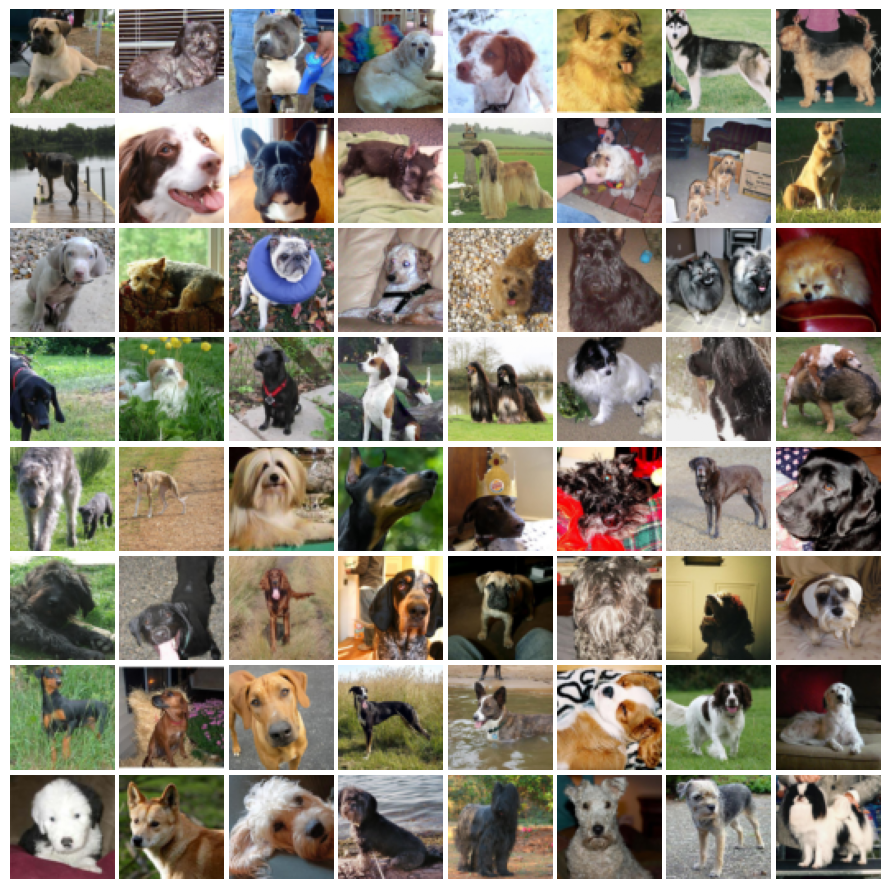

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib import animation
from PIL import Image
from IPython.display import HTML

# Point this to ffmpeg.exe on your system, may not be needed
plt.rcParams['animation.ffmpeg_path'] = 'C:/FFMpeg/bin/ffmpeg.exe'  


# Function to display images from tensor during training to visualise how GAN changes over training
def display_images_from_tensor_list(tensor_list, title=None, save_path=None, display=True):
    "Takes in 64 image tensors and plots them in a grid"
    image_tensors = [tensor.clone().cpu() for tensor in tensor_list]
    mean = torch.tensor([0.5, 0.5, 0.5]).view(3, 1, 1)
    std = torch.tensor([0.5, 0.5, 0.5]).view(3, 1, 1)
    image_tensors = [(image_tensor * std) + mean for image_tensor in image_tensors]  # Reverse normalisation
    images = [image_tensor.numpy().transpose((1, 2, 0)) for image_tensor in image_tensors]  # Reorder dims to (H, W, C)

    # Display images with matplotlib imshow in an 8x8 grid
    fig, axes = plt.subplots(8, 8, figsize=(9, 9))  # Adjust for 8x8 grid
    for idx, image in enumerate(images):
        ax = axes[idx // 8, idx % 8]  # Determine row and column index
        ax.imshow(image)
        ax.axis('off')
    if title:
        plt.suptitle(title, fontsize=18, y=0.9)
    
    # Reduce whitespace between images
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Adjust spacing between images here

    # If a save path is provided, save the fig to disk
    if save_path:
        plt.savefig(save_path)

    if display:
        plt.show()
    else:
        plt.close()
    
# Compiles validation images together into an animation
def get_training_animation(image_folder='val-images', render_every=8):
    # Get all image files, sort and load
    image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]
    image_files.sort(key=lambda x: int(x.split('-')[1].split('.')[0]))
    images = [Image.open(os.path.join(image_folder, img)) for img in image_files]

    # Build animation
    fig, ax = plt.subplots(figsize=(9, 9))
    ax.axis('off')
    im = ax.imshow(images[0])

    def update(frame):
        im.set_data(images[frame * render_every])  # Update image data, skipping every other image
        return (im,)

    # Calculate the number of frames needed when skipping every other image
    num_frames = len(images) // render_every

    ani = animation.FuncAnimation(fig, update, frames=range(num_frames), blit=True, interval=40)

    plt.tight_layout()
    plt.close()
    return ani

# Function to plot losses over training
def plot_losses(losses_generator, losses_critic, grad_penalties):
    fig, axes = plt.subplots(3, 1, figsize=(9.1, 6))
    colors = ['#636EFA', '#EF553B', '#00CC96']

    axes[0].plot(losses_generator, color=colors[0], marker='o', linestyle='-', linewidth=1, markersize=1.2)
    axes[0].set_ylabel('Generator Loss')

    axes[1].plot(losses_critic, color=colors[1], marker='o', linestyle='-', linewidth=1, markersize=1.2)
    axes[1].set_ylabel('(-) Critic Loss')
    
    axes[2].plot(grad_penalties, color=colors[2], marker='o', linestyle='-', linewidth=1, markersize=1.2)
    axes[2].set_ylabel('Gradient Penalty')
    axes[2].set_xlabel('Epoch')

    fig.suptitle('GAN Training Metrics', fontsize=18, y=0.92)

    axes[0].grid(True, which='both', linestyle='--', linewidth=0.5)
    axes[1].grid(True, which='both', linestyle='--', linewidth=0.5)
    axes[2].grid(True, which='both', linestyle='--', linewidth=0.5)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust the layout to make room for the suptitle
    plt.show()

    
# Get some images to display
np.random.seed(42)
images = [dataset.__getitem__(np.random.randint(0, len(dataset)))[0] for _ in range(64)]

# Display them
display_images_from_tensor_list(images)

## Generator and Critic Architectures
Our GAN architecture closely follows that of the tried and tested DCGAN model by Radford et al. 2015 [DCGAN paper](https://arxiv.org/abs/1511.06434) that builds on the original GAN created by Ian Goodfellow.

<img src="https://i.imgur.com/swJVYyL.png" 
     align="center" 
     width="850"
     style="padding: 20px;" />

Notable deviations our model takes from DCGAN are the inclusion of instance normalisation over batch normalisation, following suggestions made in Improved Training of Wasserstein GANS by Gulrajani et al. 2017 [paper](https://arxiv.org/abs/1704.00028), and LeakyReLU in both the generator and discriminator, a common adaption popularised by Salimans et al. 2016 in their [paper](https://arxiv.org/abs/1606.03498) Improved Techniques for Training GANs.

In [3]:
from torch import nn

class Critic(nn.Module):
    "DCGAN discriminator architecture with instance norm"
    def __init__(self):
        super().__init__()
        
        image_shape = (3, 64, 64)            # Image input shape
        n_filters = 64                       # Number of filters for final fractional convolutionl layer
        self.activation = nn.LeakyReLU(0.2)  # Model activation function
        
        # 3x64x64 -> 64x32x32
        self.conv_1 = nn.Conv2d(image_shape[0], 1*n_filters, kernel_size=5, stride=2, padding=2)
        
        # 64x32x32 -> 128x16x16
        self.conv_2 = nn.Conv2d(1*n_filters, 2*n_filters, kernel_size=5, stride=2, padding=2)
        self.norm_2 = nn.InstanceNorm2d(2*n_filters, affine=True)
        
        # 128x16x16 -> 256x8x8
        self.conv_3 = nn.Conv2d(2*n_filters, 4*n_filters, kernel_size=5, stride=2, padding=2)
        self.norm_3 = nn.InstanceNorm2d(4*n_filters, affine=True)
        
        # 256x8x8 -> 512x4x4
        self.conv_4 = nn.Conv2d(4*n_filters, 8*n_filters, kernel_size=5, stride=2, padding=2)
        self.norm_4 = nn.InstanceNorm2d(8*n_filters, affine=True)
        self.conv_out_shape = (8*n_filters, image_shape[1]//(2**4), image_shape[2]//(2**4))

        # Flatten and condense to single neuron
        self.flatten = nn.Flatten()
        self.output = nn.Linear(np.prod(self.conv_out_shape), 1)
        
    def forward(self, x):
        x = self.activation(self.conv_1(x))
        x = self.activation(self.norm_2(self.conv_2(x)))
        x = self.activation(self.norm_3(self.conv_3(x)))
        x = self.norm_4(self.conv_4(x))
        x = self.output(self.flatten(x))
        return x
    
class Generator(nn.Module):
    "DCGAN generator architecture with LeakyReLU"
    def __init__(self):
        super().__init__()
        
        z_size = 100                         # Size of input noise vector
        image_shape = (3, 64, 64)            # Image input shape
        n_filters = 64                       # Number of filters for final fractional convolutionl layer
        self.activation = nn.LeakyReLU(0.2)  # Model activation function
        
        # Calculate input shape to first transposed conv layer
        self.conv_input_shape = (16*n_filters, image_shape[1]//(2**4), image_shape[2]//(2**4))
        
        # Linear layer to map noise vector to number of tranposed conv layer inputs
        self.input = nn.Linear(z_size, np.prod(self.conv_input_shape), bias=False)
        
        # 1024x4x4 -> 512x8x8
        self.t_conv_1 = nn.ConvTranspose2d(16*n_filters, 8*n_filters, kernel_size=5, stride=2, padding=2, output_padding=1)
        self.norm_1   = nn.InstanceNorm2d(8*n_filters, affine=True)
        
        # 512x8x8 -> 256x16x16
        self.t_conv_2 = nn.ConvTranspose2d(8*n_filters, 4*n_filters, kernel_size=5, stride=2, padding=2, output_padding=1)
        self.norm_2   = nn.InstanceNorm2d(4*n_filters, affine=True)
        
        # 256x16x16 -> 128x32x32
        self.t_conv_3 = nn.ConvTranspose2d(4*n_filters, 2*n_filters, kernel_size=5, stride=2, padding=2, output_padding=1)
        self.norm_3   = nn.InstanceNorm2d(2*n_filters, affine=True)
        
        # 128x32x32 -> 3x64x64
        self.t_conv_4 = nn.ConvTranspose2d(2*n_filters, image_shape[0], kernel_size=5, stride=2, padding=2, output_padding=1)
        
    def forward(self, x):
        x = self.input(x).view((-1, *self.conv_input_shape))
        x = self.activation(self.norm_1(self.t_conv_1(x)))
        x = self.activation(self.norm_2(self.t_conv_2(x)))
        x = self.activation(self.norm_3(self.t_conv_3(x)))
        x = torch.tanh(self.t_conv_4(x))
        return x

## Gradient Penalty Calculation
The gradient penalty is used as a regularisation technique that enforces 1-Lipschitz continuity, improving training stability and speed over gradient clipping methods.

This function calculates the gradient penalty for the critic network. 

#### Process:
1. **Tensor Shapes**: Extracts the shape of the real images tensor to use for generating interpolated images.
2. **Epsilon Calculation**: Generates a random tensor from a uniform distribution between 0 and 1 for each image in the batch. This tensor determines the mix ratio between real and fake images for the interpolation.
3. **Interpolation**: Creates interpolated images by combining real and fake images according to the epsilon values.
4. **Critic Evaluation**: Passes the interpolated images through the critic to get the predictions.
5. **Gradient Computation**: Calculates the gradients of the critic's predictions with respect to the interpolated images. We use PyTorch's autograd to create and retain the computation graph as we will use it later during the critic loss backward pass.
6. **Gradient Penalty Calculation**: Computes the gradient penalty by calculating the L2 norm of the gradients, then applying the mean squared error (MSE) penalty for deviation from 1, discouraging both large and small gradients.

In [4]:
def calculate_grad_penalty(critic, images_real, images_fake, device='cpu'):
    # Get tensor shapes for image interpolation
    batch_size, channels, height, width = images_real.shape
    
    # Generate random uniform episilon tensors for interpolation
    epsilon = torch.rand((batch_size, 1, 1, 1)).repeat(1, channels, height, width).to(device)
    
    # Create interpolated images and ensure interpolated images require grad
    images_interpolated = (epsilon * images_real) + ((1 - epsilon) * images_fake)
    images_interpolated.requires_grad_(True)
    
    # Evaluate interpolated images using critic
    preds_interpolated = critic(images_interpolated)
    
    # Compute gradients of outputs w.r.t. interpolated image inputs
    gradient = torch.autograd.grad(inputs=images_interpolated, outputs=preds_interpolated,
                                   grad_outputs=torch.ones_like(preds_interpolated),
                                   create_graph=True, retain_graph=True)[0]
    
    # Flatten gradients and calculate L2 norms
    gradient = gradient.view(batch_size, -1)
    gradient_norm = gradient.norm(2, dim=1)                  
    
    # Calculate and return gradient penalty enforcing Lipschitz constraint
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)  
    return gradient_penalty

## WGAN Training Loop

This training loop implements a WGAN with Gradient Penalty (GP), optimized over a configurable number of epochs. It alternates between updating the critic, based on Wasserstein loss with gradient penalty, and the generator, aiming to improve realism of generated images.

### Training Overview:
- Critic is updated n_critic times per generator update. Critic loss combines Wasserstein loss and a gradient penalty, enforcing the Lipschitz constraint.
- Generator update aims to maximise critic scores for generated images, indirectly minimising Wasserstein distance between real and generated data distributions.

### Validation
- A Fixed noise vector is used to generate images for validation, giving a visual progress assessment.
- Generator loss, critic loss and the gradient penalty are tracked each epoch to give quantitative measures of progress.

Oweing to the stability of Wasserstein loss with a gradient penalty, this GAN training loop is far more simple than most conventional GAN training loops that require the use several 'tricks' to achieve stability.

In [5]:
import time

def train(generator, critic, dataloader, config=None):
    "Trains GAN model for specified number of epochs"
    device       = config['device']       if config else 'cpu' # Device to train model on
    n_epochs     = config['n_epochs']     if config else 10    # Max number of training epochs
    batch_size   = config['batch_size']   if config else 32    # Batch size
    z_size       = config['z_size']       if config else 100   # Latent noise vector size
    n_critic     = config['n_critic']     if config else 5     # Number of critic updates per generator update
    lr_generator = config['lr_generator'] if config else 1e-4  # Generator learning rate
    lr_critic    = config['lr_critic']    if config else 1e-4  # Critic learning rate
    gp_lambda    = config['gp_lambda']    if config else 10.   # Weight of gradient penalty in critic loss
    adam_b1      = config['adam_b1']      if config else 0.    # No momentum used in original paper
    adam_b2      = config['adam_b2']      if config else 0.9   # Adam Beta 2 value
    verbose      = config['verbose']      if config else True  # Verbose will print logs and display images
    
    # Move generator and critic networks to device
    generator = generator.to(device)
    critic    = critic.to(device)
    
    # Optimisers for generator and critic
    opt_generator = torch.optim.Adam(generator.parameters(), lr=lr_generator, betas=(adam_b1, adam_b2))
    opt_critic    = torch.optim.Adam(critic.parameters(),    lr=lr_critic,    betas=(adam_b1, adam_b2))
    
    # Noise we will keep the same for displaying 64 validation images
    val_noise = torch.randn((64, z_size)).to(device)
    
    # Tracking and logging
    steps_per_epoch = len(dataloader.dataset) // (n_critic * batch_size) # Number of full training steps per epoch
    step_loss_generator = step_loss_critic = step_grad_penalty = 0.      
    epoch_losses_generator = []                        # Lists containing losses for each epoch
    epoch_losses_critic = []
    epoch_grad_penalties = []
    
    critic_update_count = 0                            # Counts number of times critic has been updated
    
    
    for epoch in range(1, n_epochs + 1):
        if verbose: print(f"\nEpoch {epoch}")
        
        # Reset losses and time
        step = 1                        # A step refers to a full generator update and critic update(s)
        epoch_loss_generator = 0.       # Total generator loss accumulated over an epoch
        epoch_loss_critic    = 0.       # Total critic loss accumulated over an epoch
        epoch_grad_penalty   = 0.
        epoch_start_time = time.time()  # Time epoch began
        
        # Ensure both models are set to training mode in case of batch norm/dropout
        generator.train()
        critic.train()
        
        for idx, (images, _) in enumerate(dataloader):
            # Train critic
            noise        = torch.randn((batch_size, z_size)).to(device)
            images_fake  = generator(noise).detach()
            images_real  = images.to(device)
            preds_fake   = critic(images_fake)
            preds_real   = critic(images_real)
            grad_penalty = gp_lambda * calculate_grad_penalty(critic, images_real, images_fake, device)
            loss_critic  = -(torch.mean(preds_real) - torch.mean(preds_fake)) + grad_penalty
            
            # Logging
            step_loss_critic += loss_critic.item()  
            step_grad_penalty += grad_penalty.item()
            
            opt_critic.zero_grad()
            loss_critic.backward()
            opt_critic.step()
            
            # Check to see if critic training should continue
            critic_update_count += 1
            if critic_update_count < n_critic:
                continue
            else:
                critic_update_count = 0
            
            # Train generator
            noise          = torch.randn((batch_size, z_size)).to(device)
            images_fake    = generator(noise)
            loss_generator = -torch.mean(critic(images_fake))
            
            step_loss_generator = loss_generator.item()  # Logging
            
            opt_generator.zero_grad()
            loss_generator.backward()
            opt_generator.step()
            
            # Logging
            epoch_loss_generator += step_loss_generator
            epoch_loss_critic    += step_loss_critic  / n_critic
            epoch_grad_penalty   += step_grad_penalty / n_critic
            step_loss_generator   = step_loss_critic  = step_grad_penalty = 0.
            
            if verbose: print(f"\rStep {step} \
            Generator loss: {epoch_loss_generator / step:.3f}    Critic loss: {epoch_loss_critic / step:.3f}    Grad Penalty: {epoch_grad_penalty / step:.3f} \
            Elapsed time: {time.time() - epoch_start_time:.1f}s", end='')
            step += 1
        
        # Validation
        generator.eval()
        with torch.no_grad():
            val_images = generator(val_noise)
        val_images = [image for image in val_images]
        display_images_from_tensor_list(val_images, save_path=f'val-images/epoch-{epoch}.png', display=verbose)
        epoch_losses_generator.append(epoch_loss_generator / step) # Step is at max, so this scales down to consistent range
        epoch_losses_critic.append(-epoch_loss_critic / step)
        epoch_grad_penalties.append(epoch_grad_penalty / step)
        
    return epoch_losses_generator, epoch_losses_critic, epoch_grad_penalties

## Build and Train Model
We define our training configuration, build our generator and critic models and begin training.

In [6]:
train_config = {
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',   # Device to train model on
    'n_epochs':     4000,  # Max number of training epochs
    'batch_size':     32,  # Batch size, 64 in original paper
    'z_size':        100,  # Latent noise vector size
    'n_critic':        5,  # Number of critic updates per one generator update
    'lr_generator': 1e-4,  # Generator learning rate
    'lr_critic':    1e-4,  # Critic learning rate
    'gp_lambda':      10,  # Weight of gradient penalty in critic loss
    'adam_b1':       0.5,  # No momentum used in original paper
    'adam_b2':       0.9,  # Adam beta 2 value
    'verbose':     False,  # Verbose will print logs and display images during training
}

# Initialise GAN and count parameters
generator = Generator()
critic = Critic()
print(f"{sum(p.numel() for p in generator.parameters()):,} trainable parameters in generator network")
print(f"{sum(p.numel() for p in critic.parameters()):,} trainable parameters in critic network")

# Create dataloader
dataloader = DataLoader(dataset, batch_size=train_config['batch_size'], shuffle=True, drop_last=True)

# Train model and get losses
losses_generator, losses_critic, grad_penalties = train(generator, critic, dataloader, train_config)

# Save generator and critic weights to disk
generator_state_dict = generator.state_dict()
critic_state_dict = critic.state_dict()
torch.save(generator_state_dict, 'models/generator_parameters.pth')
torch.save(critic_state_dict, 'models/critic_parameters.pth')

18,853,891 trainable parameters in generator network

4,316,545 trainable parameters in critic network


### Training Information
Finally, let's have a look at our losses during training as well as an animation of the whole training process on some fixed validation noise:

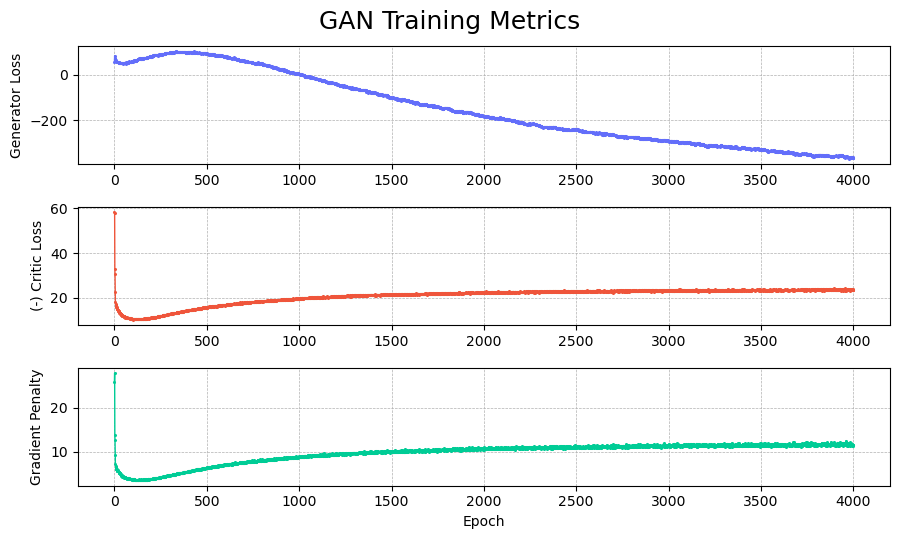

In [9]:
plot_losses(losses_generator, losses_critic, grad_penalties)

ani = get_training_animation()
HTML(ani.to_html5_video())